## 회고

#### Point 1) 코드 해석의 어려움
- 요즘 논문과 이를 토대로한 어려운 코드들을 정말 많이 보게 된다...(개인적으로 object detection 코드 리뷰 스터디에도 참여하고 있는데, 몇 주 동안 머리가 지끈지끈하다.)
- 사실 이번 프로젝트에 쓰인 코드도 전부 다 해석해보려 했으나(어떤 원리인지 모르면 디버깅할 때 어디가 문제인지도 모를 터이니...), 이미지 전처리 부분 이후부터는 이해가 잘 되지 않아 나의 정신 건강을 위해 넘어가기로 했다.
- 그냥 궁금하다. 현업에서 일하시는 분들은 이번 노드의 코드를 얼마나 빠르고 정확하게 이해하실까...?
- 점점 할 게 많아지고, 특히 깊이 이해하지 못하면 더 앞으로 못 나아가는 요즘, 이럴 때일수록 하나씩 차근차근 풀어가는 지혜가 필요한 것 같다.

#### Point 2) bbox 시각화시 생기는 상하반전 문제
- 추론 단계까지 가서 시각화를 했는데 시각화된 bbox들이 대부분 자동차 위에 붕붕 떠있었다.
- 처음에는 '모델 훈련이 아직 덜 된 건가' 싶어서 몇 시간에 걸쳐서 모델 훈련을 시켜봤는데, 결과는 그대로였다.
- '원인이 뭘까? 아 코드 보느라 너무 힘들었는데 그냥 지나칠까'하다가 곰곰히 생각해보니 bbox의 모양과 score는 정상이었고 다만 bbox 위치만 뭔가 이상했다. 바로 상하 반전된 상태였던 것이다.
- 그 순간 프로젝트 초기에 bbox를 시각화하는 함수에서 발견했던 아리송한 부분이 떠올랐고, 결과적으로 이번 데이터셋의 bbox 시각화를 위해서는 시각화할 때 `상하 반전`이 필요할 수 있겠다라는 생각이 들었다.
- 얼핏 찾아보니 이번 프로젝트 노드의 코드는 keras RetinaNet tutorial에서 갖고 온 코드였고, 튜토리얼 내 사용된 데이터셋이 이번 데이터셋과 다른 것을 파악하고는 나의 추론에 더욱 더 확신이 들었다.
- 결론적으로 `y_min, y_max`의 경우 `predict` 된 값을 `height`에서 빼줌을 통해 상하 반전을 꾀했고, 이를 통해 정상적인 시각화를 이룰 수 있었다.**(예 : `y_min = height - y_min`)**

#### Point 3) 프로젝트 마지막 부분의 Go, Stop 반환 로직 만들기
- 결과적으로 이번 모델과 내가 만든 코드를 통해서 Go, Stop 반환 로직을 만들었을 경우 보유한 테스트셋에서는 80점이라는 결과가 나왔다.
- 제대로 판별하지 못한 2가지 경우 1개는 제일 큰 차를 모델이 인식하지 못했고, 다른 1개는 나의 코드 구현 문제인지 큰 차를 인식했고 직관적으로 보기에도 pixel이 `300`이 넘지만, 계산한 결과 약 `50`pixel 밖에 나오지 않는 것으로 찍혔다.
- 이 또한 왜일까...? 해당 부분은 어느 정도 노력해서 이 정도까지 이루었기에 다음 task로 일단 넘어가려 한다... 수고했다 DJ...!

## 프로젝트: 자율주행 보조 시스템 만들기

#### 배경
- KITTI 데이터셋을 확인해봤다.
- 아직 이해는 안 가지만 RetinaNet과 해당 모델을 토대로 한 Object-Detection task의 구현 코드를 확인해봤다.
- 위의 배경지식을 토대로 모델에 주행 차량의 시선에서 바라본 이미지를 넣었을 때 `Go` 혹은 `Stop`의 신호를 return하는 자율주행 보조 시스템을 만들어보자.

### 1) 라이브러리 버전 확인
---

In [1]:
import os, copy
import numpy as np
import tensorflow as tf
import tensorflow_datasets as tfds
from google.colab import drive
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw

drive.mount("/content/drive")

Mounted at /content/drive


### 2) 데이터셋 가져오기
---
- 이번 프로젝트에서는 **KITTI 데이터셋**을 사용해서 object detection을 구현하고 이해해본다.

In [2]:
DATA_PATH = "/content/drive/My Drive/Aiffel/GD_08/data"

In [3]:
# 데이터 가져오기
(ds_train, ds_test), ds_info = tfds.load(
    'kitti',
    data_dir=DATA_PATH,
    split=['train', 'test'],
    shuffle_files=True,
    with_info=True)

In [4]:
print(f"ds_train numbers : {ds_train.cardinality()}")
print(f"ds_test numbers : {ds_test.cardinality()}")

ds_train numbers : 6347
ds_test numbers : 711


In [5]:
# 데이터셋 구조 및 정보 확인
ds_info

tfds.core.DatasetInfo(
    name='kitti',
    version=3.2.0,
    description='Kitti contains a suite of vision tasks built using an autonomous driving
platform. The full benchmark contains many tasks such as stereo, optical flow,
visual odometry, etc. This dataset contains the object detection dataset,
including the monocular images and bounding boxes. The dataset contains 7481
training images annotated with 3D bounding boxes. A full description of the
annotations can be found in the readme of the object development kit readme on
the Kitti homepage.',
    homepage='http://www.cvlibs.net/datasets/kitti/',
    features=FeaturesDict({
        'image': Image(shape=(None, None, 3), dtype=tf.uint8),
        'image/file_name': Text(shape=(), dtype=tf.string),
        'objects': Sequence({
            'alpha': tf.float32,
            'bbox': BBoxFeature(shape=(4,), dtype=tf.float32),
            'dimensions': Tensor(shape=(3,), dtype=tf.float32),
            'location': Tensor(shape=(3,), dtype

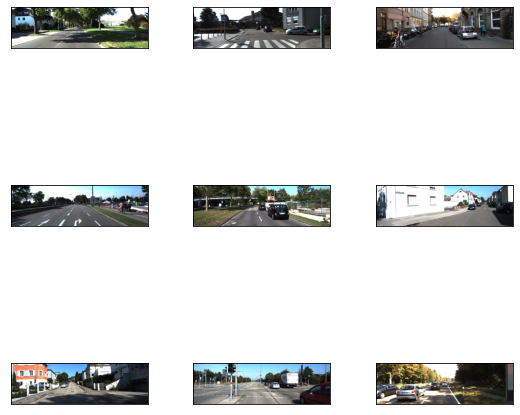

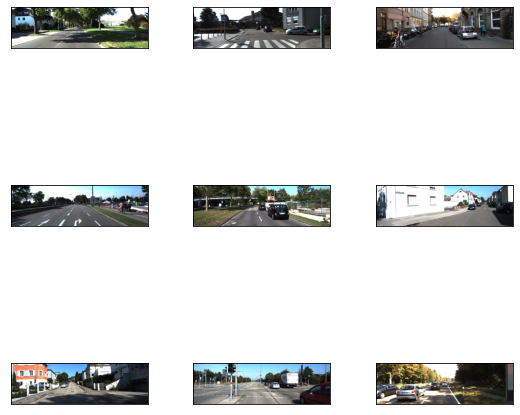

In [6]:
# 예시 시각화
tfds.show_examples(ds_train, ds_info)

In [7]:
# 데이터 구조 확인
ds_train.take(1).element_spec

{'image': TensorSpec(shape=(None, None, 3), dtype=tf.uint8, name=None),
 'image/file_name': TensorSpec(shape=(), dtype=tf.string, name=None),
 'objects': {'alpha': TensorSpec(shape=(None,), dtype=tf.float32, name=None),
  'bbox': TensorSpec(shape=(None, 4), dtype=tf.float32, name=None),
  'dimensions': TensorSpec(shape=(None, 3), dtype=tf.float32, name=None),
  'location': TensorSpec(shape=(None, 3), dtype=tf.float32, name=None),
  'occluded': TensorSpec(shape=(None,), dtype=tf.int64, name=None),
  'rotation_y': TensorSpec(shape=(None,), dtype=tf.float32, name=None),
  'truncated': TensorSpec(shape=(None,), dtype=tf.float32, name=None),
  'type': TensorSpec(shape=(None,), dtype=tf.int64, name=None)}}

In [8]:
# TakeDataset의 내부 데이터 하나씩 다 꺼내보기
for sample_1 in ds_train.take(1):
    break

In [9]:
# 타입 확인
type(sample_1)

dict

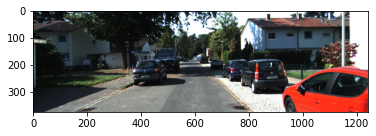

TensorShape([375, 1242, 3])

In [10]:
# 데이터 확인 - 이미지
img = Image.fromarray(sample_1['image'].numpy())
plt.imshow(img)
plt.show()

sample_1['image'].shape

In [11]:
# 데이터 확인 - 이미지 파일 이름
sample_1['image/file_name'].numpy().decode(encoding='utf-8')

'007138.png'

In [12]:
# 데이터 확인 - alpha
sample_1['objects']['alpha']

<tf.Tensor: shape=(7,), dtype=float32, numpy=array([-1.37, -1.88, -1.77,  1.7 , -1.63, -1.6 , -2.23], dtype=float32)>

In [13]:
# 데이터 확인 - bbox
sample_1['objects']['bbox']

<tf.Tensor: shape=(7, 4), dtype=float32, numpy=
array([[0.24994667, 0.2973108 , 0.52168   , 0.40366346],
       [0.17834666, 0.6147907 , 0.5295733 , 0.7669726 ],
       [0.28474668, 0.56700486, 0.51584   , 0.660314  ],
       [0.40186667, 0.36808375, 0.6414667 , 0.43763286],
       [0.41714665, 0.53014493, 0.526     , 0.56913847],
       [0.46928   , 0.501715  , 0.5439467 , 0.5234461 ],
       [0.00266667, 0.7391385 , 0.5110667 , 0.99919486]], dtype=float32)>

> **note**:
> - 오늘 프로젝트에서 중요한 데이터셋 내 bbox는 tensorflow `BBoxFeature` 자료형으로서 `y_min, x_min, y_max, x_max`의 4개 값을 가진다.

In [14]:
# 데이터 확인 - dimensions
sample_1['objects']['dimensions']

<tf.Tensor: shape=(7, 3), dtype=float32, numpy=
array([[1.65, 1.67, 3.81],
       [1.52, 1.51, 3.1 ],
       [1.53, 1.58, 3.53],
       [2.6 , 2.06, 5.42],
       [1.46, 1.6 , 3.71],
       [1.97, 1.82, 4.41],
       [1.57, 1.72, 3.52]], dtype=float32)>

In [15]:
# 데이터 확인 - location
sample_1['objects']['location']

<tf.Tensor: shape=(7, 3), dtype=float32, numpy=
array([[-3.19,  1.78, 13.7 ],
       [ 3.19,  1.59,  9.99],
       [ 2.91,  1.71, 14.66],
       [-3.48,  1.52, 23.76],
       [ 2.71,  1.66, 27.9 ],
       [ 1.91,  1.87, 53.43],
       [ 3.18,  1.64,  3.76]], dtype=float32)>

In [16]:
# 데이터 확인 - occluded
sample_1['objects']['occluded']

<tf.Tensor: shape=(7,), dtype=int64, numpy=array([0, 1, 2, 2, 0, 0, 0])>

In [17]:
# 데이터 확인 - rotation_y
sample_1['objects']['rotation_y']

<tf.Tensor: shape=(7,), dtype=float32, numpy=array([-1.6 , -1.58, -1.58,  1.56, -1.54, -1.57, -1.57], dtype=float32)>

In [18]:
# 데이터 확인 - truncated
sample_1['objects']['truncated']

<tf.Tensor: shape=(7,), dtype=float32, numpy=array([0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.91], dtype=float32)>

In [19]:
# 데이터 확인 - type
print(sample_1['objects']['type'])

tf.Tensor([0 0 0 2 0 1 0], shape=(7,), dtype=int64)


> **note**:
> - 하나의 데이터셋 샘플에는 10개의 내부 데이터가 담겨 있고, 이것들은 딕셔너리의 key-value 형태로 담겨 있다.
> - 이 중 `image`, `image/file_name`을 제외한 8개는 `objects`라는 내부 딕셔너리에 key-value 형태로 저장되어 있다.
> - 여기서 필요한 데이터는 `image`, `bbox` 정도인 것 같다.

#### Bbox 시각화 함수

In [21]:
def visualize_bbox(input_image, object_bbox):

    input_image = copy.deepcopy(input_image)
    
    if type(input_image) != np.ndarray:
        input_image = input_image.numpy()
    if type(object_bbox) != np.ndarray:
        object_bbox = object_bbox.numpy()

    input_image = Image.fromarray(input_image)


    draw = ImageDraw.Draw(input_image)
    
    # 바운딩 박스 좌표(x_min, x_max, y_min, y_max) 구하기
    width, height = img.size
    x_min = object_bbox[:,1] * width
    x_max = object_bbox[:,3] * width
    y_min = height - object_bbox[:,0] * height
    y_max = height - object_bbox[:,2] * height
    
    # 바운딩 박스 그리기
    rects = np.stack([x_min, y_min, x_max, y_max], axis=1)
    for _rect in rects:
        draw.rectangle(_rect, outline=(255,0,0), width=2)

    return input_image

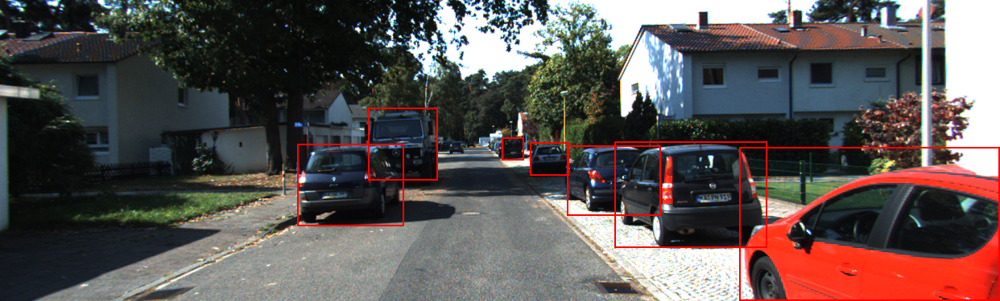

In [22]:
# 테스트해보기
visualize_bbox(sample_1['image'], sample_1['objects']['bbox'])

#### 하나의 데이터셋 샘플만 랜덤으로 뽑는 함수

In [23]:
# 함수 정의
def take_one_sample(ds):
    ds = ds.shuffle(1000)
    ds = ds.take(1)
    ds_list = list(ds.as_numpy_iterator())
    return ds_list[0]

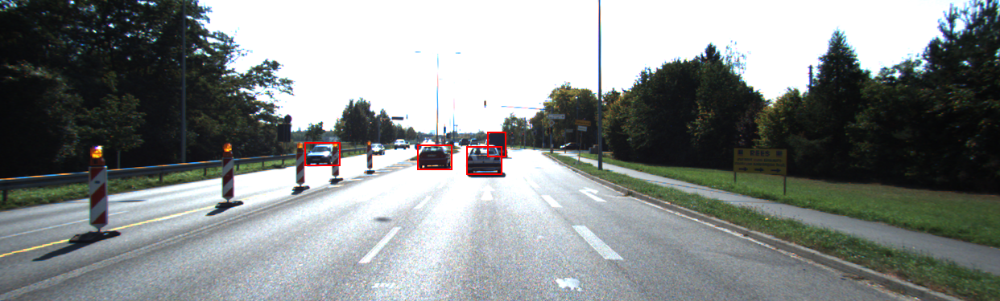

In [24]:
sample_2 = take_one_sample(ds_train)

visualize_bbox(sample_2['image'], sample_2['objects']['bbox'])

> **note**:
> - 현재 tensorflow KITTI 데이터셋에 담겨 있는 BBOX의 정보가 내가 이해하는 것과 약간 다른 것 같다.
> - 특히 y좌표 값이 생각과 다른데, 위의 코드를 보면 `y_min`과 `y_max`를 절대적인 이미지 크기의 값으로 바꿀 때는 `height`에서 빼주면서 상하반전을 꾀하고 있다.
> - 아래를 통해 실험해보겠지만, 내 생각에는 흔히 알고 있듯이 **y좌표**가 이미지 상단에서 0으로 시작해서 하단으로 갈수록 값이 커지는 게 아니라, 하단에서 0으로 시작해서 상단으로 갈수록 값이 커지는 것 같다.

In [25]:
# 상하 반전을 꾀하지 않고 했을 때 어떻게 되는지 확인
def visualize_bbox_dj(input_image, object_bbox):

    input_image = copy.deepcopy(input_image)
    
    if type(input_image) != np.ndarray:
        input_image = input_image.numpy()
    if type(object_bbox) != np.ndarray:
        object_bbox = object_bbox.numpy()

    input_image = Image.fromarray(input_image)


    draw = ImageDraw.Draw(input_image)
    
    # 바운딩 박스 좌표(x_min, x_max, y_min, y_max) 구하기
    width, height = img.size
    x_min = object_bbox[:,1] * width
    x_max = object_bbox[:,3] * width
    y_min = object_bbox[:,0] * height # 이 부분 내가 이해하는 로직으로 변경
    y_max = object_bbox[:,2] * height # 이 부분 내가 이해하는 로직으로 변경
    
    # 바운딩 박스 그리기
    rects = np.stack([x_min, y_min, x_max, y_max], axis=1)
    for _rect in rects:
        draw.rectangle(_rect, outline=(255,0,0), width=2)

    return input_image

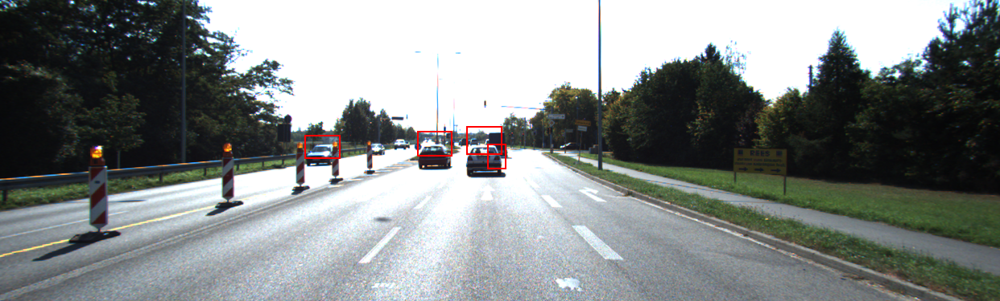

In [26]:
visualize_bbox_dj(sample_2['image'], sample_2['objects']['bbox'])

> **note**:
> - 찾다보니까 tensorflow에도 bounding box를 그리게 해주는 함수가 있다.
> - 한번 시도해봤다.

In [28]:
# Tensorflow 함수 사용
def tf_visualize_bbox(img, bbox):
    if len(img.shape) == 3:
        img = tf.expand_dims(img, axis=0)
    
    img = tf.cast(img, dtype=tf.float32)

    if len(bbox.shape) == 2:
        bbox = tf.expand_dims(bbox, axis=0)
    
    colors = tf.constant([[255.0, 0.0, 0.0]])

    bbox_on_img = tf.image.draw_bounding_boxes(img, bbox, colors)
    bbox_on_img = tf.squeeze(bbox_on_img)
    bbox_on_img = tf.cast(bbox_on_img, dtype=tf.int32)
    
    return bbox_on_img.numpy()

In [29]:
# 같은 이미지에 테스트해보기
tf_visualisation = tf_visualize_bbox(sample_2['image'], sample_2['objects']['bbox'])

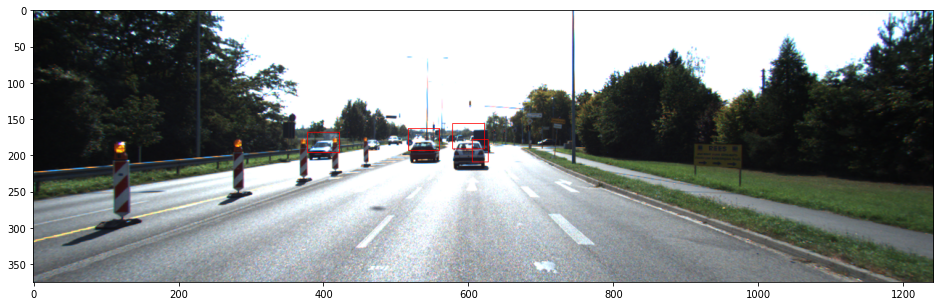

In [30]:
# 시각화
plt.figure(figsize=(20, 5))
plt.imshow(tf_visualisation)
plt.show()

> **note**:
> - `tfds`에 있는 데이터셋의 `bbox`값을 그대로 tensorflow 내장 함수에 썼는데 저렇게 상하반전이 이루어진 것을 보면 KITTI데이터셋만 그런건지는 모르지만, 내가 이해하는 x, y좌표와 다르게 값이 반영되어 있는 것 같다.(아니면 원래 그런건가...)

### 3) 데이터 파이프라인 만들기
---
- KITTI 데이터셋을 훈련 모델에 맞게 바꾸면서 파이프라인화해야 한다. 바뀔 내역은 아래와 같다.
  - x와 y좌표 위치 교체
  - 무작위로 수평 뒤집기(Flip)
  - 이미지 크기 조정 및 패딩 추가
  - 좌표계를 `[x_min, y_min, x_max, y_max]`에서 `[x_min, y_min, width, height]`으로 수정

- 이를 위한 함수들을 정의한다.

#### bbox에서 x, y 좌표 위치 바꿔주는 함수

In [31]:
def swap_xy(boxes):
    return tf.stack([boxes[:, 1], boxes[:, 0], boxes[:, 3], boxes[:, 2]], axis=-1)

#### 데이터 증강을 위한 좌우반전 함수

In [32]:
def random_flip_horizontal(image, boxes):
    if tf.random.uniform(()) > 0.5:
        image = tf.image.flip_left_right(image)
        boxes = tf.stack(
           [1 - boxes[:, 2], boxes[:, 1], 1 - boxes[:, 0], boxes[:, 3]], axis=-1
        )
        
    return image, boxes

> **note**:
> - 생각해보니 `tf.image.random_flip_left_right()`함수도 있는데 왜 굳이 `tf.random.uniform()`을 통해 `1/2` 확률을 만들까 생각했는데, 이미지가 좌우반전될 경우 `bbox`도 같이 바뀌어야 해서인 것 같다. 즉, 이미지만 바뀌는 함수 대신 하나의 확률 안에 이미지와 bbox 같이 바꾸려면 저렇게 구현해야 하는 것 같다.

#### 데이터 증강을 위해 이미지 크기를 변경하고, 필요 시 zero패딩 해주는 함수

In [33]:
def resize_and_pad_image(image, training=True):

    # 범위 지정
    min_side = 800.0
    max_side = 1333.0
    min_side_range = [640, 1024]
    stride = 128.0
    
    # 기본 정보 할당
    image_shape = tf.cast(tf.shape(image)[:2], dtype=tf.float32)

    # 훈련 시에만 이미지 크기를 변경
    if training:
        min_side = tf.random.uniform((), min_side_range[0], min_side_range[1], dtype=tf.float32)

    # 원본 크기에 대한 새로 바꿀 크기의 비율 구하기
    ratio = min_side / tf.reduce_min(image_shape)

    # 만약 그 비율을 원본에 적용했을 때 일정 범위를 넘어서면 넘어서지 않도록 다시 설정
    if ratio * tf.reduce_max(image_shape) > max_side:
        ratio = max_side / tf.reduce_max(image_shape)

    # 구해진 비율로 이미지 크기 바꾸기    
    image_shape = ratio * image_shape

    # 해당 사이즈로 리사이즈
    image = tf.image.resize(image, tf.cast(image_shape, dtype=tf.int32))

    # stride에 맞는 크기로 변경해서 남는 공간은 zero-padding
    padded_image_shape = tf.cast(
        tf.math.ceil(image_shape / stride) * stride, dtype=tf.int32
    )
    image = tf.image.pad_to_bounding_box(
        image, 0, 0, padded_image_shape[0], padded_image_shape[1]
    )
    return image, image_shape, ratio

> **note**:
> - 위의 함수는 이미지를 일정한 범위의 크기 내에서 랜덤으로 변경해주는 것 같다.
> - 여기서 `min_side`와 `max_side`는 데이터셋의 특징과 뭔가 연관되어서 정해놓은 값이 아닐까 추측한다.
> - `stride`를 `128`로 설정한 이유는 모델의 구조와 연관된 것 같다.

#### bbox 좌표를 `xywh` 구조로 바꾸는 함수

In [34]:
def convert_to_xywh(boxes):
    return tf.concat(
        [(boxes[..., :2] + boxes[..., 2:]) / 2.0, boxes[..., 2:] - boxes[..., :2]],
        axis=-1,
    )

> **note**:
> - 이 코드가 하는 것은, 위에서 x, y 좌표가 바뀐 bounding box에 대해서 `x_center, y_center, widht, height`좌표로 바꿔주는 건데,
> - `center` 들은 서로 대응하는 것들끼리 더해서 2로 나누고, 
> - `width`와 `height`은 서로 대응하는 것들끼리 `max`에서 `min` 빼주는 것 같다.


#### 전체 데이터셋에 map으로 적용해줄 이미지 전처리 함수

In [35]:
def preprocess_data(sample):
    image = sample["image"]

    # bbox x, y 좌표 바꾸기
    bbox = swap_xy(sample["objects"]["bbox"])
    class_id = tf.cast(sample["objects"]["type"], dtype=tf.int32)
    
    # random으로 좌우 반전
    image, bbox = random_flip_horizontal(image, bbox)
    
    # 이미지 사이즈 변경
    image, image_shape, _ = resize_and_pad_image(image)

    # bbox를 전체 이미지 크기에 맞게 denormalise
    bbox = tf.stack(
        [
            bbox[:, 0] * image_shape[1], # 높이 곱해줌
            bbox[:, 1] * image_shape[0], # 이건 넓이
            bbox[:, 2] * image_shape[1],
            bbox[:, 3] * image_shape[0],
        ],
        axis=-1,
    )

    # bbox 좌표값 형식 바꾸기
    bbox = convert_to_xywh(bbox)
    return image, bbox, class_id

#### 데이터 샘플마다 AnchorBox 만드는 클래스

In [36]:
# _compute_dims() 작동법 확인 (1)
aspect_ratios = [0.5, 1.0, 2.0]                                   # 앵커박스의 가로세로 비율 종류
scales = [2 ** x for x in [0, 1 / 3, 2 / 3]]                      # 앵커박스 스케일 종류

num_anchors = len(aspect_ratios) * len(scales)                    # 하나의 셀당 앵커박스 수
_strides = [2 ** i for i in range(3, 8)]
_areas = [x ** 2 for x in [32.0, 64.0, 128.0, 256.0, 512.0]]

In [37]:
# 작동법 확인 (2)
print(f"strides : {_strides}")
print(f"areas : {_areas}")

strides : [8, 16, 32, 64, 128]
areas : [1024.0, 4096.0, 16384.0, 65536.0, 262144.0]


In [38]:
# 작동법 확인 (3)
for area in _areas:
    for ratio in aspect_ratios:
        anchor_height = tf.math.sqrt(area / ratio)
        print(f"area({area}) / ratio({ratio}) **(1/2) = anchor_height({anchor_height}) <============ 1")
        anchor_width = area / anchor_height
        print(f"area({area}) / anchor_height({anchor_height}) = anchor_width({anchor_width}) <============ 2")
        dims = tf.reshape(
            tf.stack([anchor_width, anchor_height], axis=-1), [1, 1, 2]
        )
        print(dims, "<============= 3")
        print()
        print()

area(1024.0) / ratio(0.5) **(1/2) = anchor_height(45.25483322143555) <============ 1
area(1024.0) / anchor_height(45.25483322143555) = anchor_width(22.627416610717773) <============ 2
tf.Tensor([[[22.627417 45.254833]]], shape=(1, 1, 2), dtype=float32) <============= 3


area(1024.0) / ratio(1.0) **(1/2) = anchor_height(32.0) <============ 1
area(1024.0) / anchor_height(32.0) = anchor_width(32.0) <============ 2
tf.Tensor([[[32. 32.]]], shape=(1, 1, 2), dtype=float32) <============= 3


area(1024.0) / ratio(2.0) **(1/2) = anchor_height(22.627416610717773) <============ 1
area(1024.0) / anchor_height(22.627416610717773) = anchor_width(45.25483322143555) <============ 2
tf.Tensor([[[45.254833 22.627417]]], shape=(1, 1, 2), dtype=float32) <============= 3


area(4096.0) / ratio(0.5) **(1/2) = anchor_height(90.5096664428711) <============ 1
area(4096.0) / anchor_height(90.5096664428711) = anchor_width(45.25483322143555) <============ 2
tf.Tensor([[[45.254833 90.50967 ]]], shape=(1, 1, 2), 

In [39]:
# 작동법 확인 (4)
anchor_dims_all = []
for area in _areas:
    anchor_dims = []
    for ratio in aspect_ratios:
        anchor_height = tf.math.sqrt(area / ratio)
        anchor_width = area / anchor_height
        dims = tf.reshape(
            tf.stack([anchor_width, anchor_height], axis=-1), [1, 1, 2]
        )
        for scale in scales:
            anchor_dims.append(scale * dims)
    anchor_dims_all.append(tf.stack(anchor_dims, axis=-2))

In [40]:
# 작동법 확인 (5)
anchor_dims_all

[<tf.Tensor: shape=(1, 1, 9, 2), dtype=float32, numpy=
 array([[[[22.627417, 45.254833],
          [28.508759, 57.017517],
          [35.918785, 71.83757 ],
          [32.      , 32.      ],
          [40.317474, 40.317474],
          [50.796833, 50.796833],
          [45.254833, 22.627417],
          [57.017517, 28.508759],
          [71.83757 , 35.918785]]]], dtype=float32)>,
 <tf.Tensor: shape=(1, 1, 9, 2), dtype=float32, numpy=
 array([[[[ 45.254833,  90.50967 ],
          [ 57.017517, 114.035034],
          [ 71.83757 , 143.67514 ],
          [ 64.      ,  64.      ],
          [ 80.63495 ,  80.63495 ],
          [101.593666, 101.593666],
          [ 90.50967 ,  45.254833],
          [114.035034,  57.017517],
          [143.67514 ,  71.83757 ]]]], dtype=float32)>,
 <tf.Tensor: shape=(1, 1, 9, 2), dtype=float32, numpy=
 array([[[[ 90.50967 , 181.01933 ],
          [114.035034, 228.07007 ],
          [143.67514 , 287.35028 ],
          [128.      , 128.      ],
          [161.2699  

> **note**:
> - 작동법이 잘 이해가지 않는다....
> - 일단 코드 진행 후 넘어가기로 한다.

In [42]:
class AnchorBox:
    def __init__(self):

        self.aspect_ratios = [0.5, 1.0, 2.0]                                   # 앵커박스의 가로세로 비율 종류
        self.scales = [2 ** x for x in [0, 1 / 3, 2 / 3]]                      # 앵커박스 스케일 종류

        self._num_anchors = len(self.aspect_ratios) * len(self.scales)         # 하나의 셀당 앵커박스 수
        self._strides = [2 ** i for i in range(3, 8)]
        self._areas = [x ** 2 for x in [32.0, 64.0, 128.0, 256.0, 512.0]]
        self._anchor_dims = self._compute_dims()

    def _compute_dims(self):
        anchor_dims_all = []
        for area in self._areas:
            anchor_dims = []
            for ratio in self.aspect_ratios:
                anchor_height = tf.math.sqrt(area / ratio)
                anchor_width = area / anchor_height
                dims = tf.reshape(
                    tf.stack([anchor_width, anchor_height], axis=-1), [1, 1, 2]
                )
                for scale in self.scales:
                    anchor_dims.append(scale * dims)
            anchor_dims_all.append(tf.stack(anchor_dims, axis=-2))
        return anchor_dims_all

    def _get_anchors(self, feature_height, feature_width, level):
        rx = tf.range(feature_width, dtype=tf.float32) + 0.5 # range같이 0 ~ width까지의 값을 배열로 만듦(추가로 + 0.5)
        ry = tf.range(feature_height, dtype=tf.float32) + 0.5
        centers = tf.stack(tf.meshgrid(rx, ry), axis=-1) * self._strides[level - 3]
        centers = tf.expand_dims(centers, axis=-2)
        centers = tf.tile(centers, [1, 1, self._num_anchors, 1])
        dims = tf.tile(
            self._anchor_dims[level - 3], [feature_height, feature_width, 1, 1]
        )
        anchors = tf.concat([centers, dims], axis=-1)
        return tf.reshape(
            anchors, [feature_height * feature_width * self._num_anchors, 4]
        )

    def get_anchors(self, image_height, image_width):
        anchors = [
            self._get_anchors(
                tf.math.ceil(image_height / 2 ** i),
                tf.math.ceil(image_width / 2 ** i),
                i,
            )
            for i in range(3, 8)
        ]
        return tf.concat(anchors, axis=0)

> **note**:
> - 내가 이해하기로는 `translation-invariant`한 앵커박스, 즉 계속해서 고정된 크기의 앵커박스를 생성하기 위한 코드인 것 같다...

#### bbox를 코너 형태의 bbox로 바꿔주는 함수 및 이를 토대로 IoU를 계산하는 함수

In [43]:
def convert_to_corners(boxes):
    return tf.concat(
        [boxes[..., :2] - boxes[..., 2:] / 2.0, boxes[..., :2] + boxes[..., 2:] / 2.0],
        axis=-1,
    )

def compute_iou(boxes1, boxes2):
    boxes1_corners = convert_to_corners(boxes1)
    boxes2_corners = convert_to_corners(boxes2)
    lu = tf.maximum(boxes1_corners[:, None, :2], boxes2_corners[:, :2])
    rd = tf.minimum(boxes1_corners[:, None, 2:], boxes2_corners[:, 2:])
    intersection = tf.maximum(0.0, rd - lu)
    intersection_area = intersection[:, :, 0] * intersection[:, :, 1]
    boxes1_area = boxes1[:, 2] * boxes1[:, 3]
    boxes2_area = boxes2[:, 2] * boxes2[:, 3]
    union_area = tf.maximum(
        boxes1_area[:, None] + boxes2_area - intersection_area, 1e-8
    )
    return tf.clip_by_value(intersection_area / union_area, 0.0, 1.0)

#### 라벨 인코더
- 코드 한 줄씩 전체는 파악 안되지만, 인터넷 튜토리얼 글을 통해 이해했을 땐 raw한 라벨을 훈련 시 필요한 형식의 라벨로 바꿔주는 클래스이다.

In [44]:
class LabelEncoder:

    def __init__(self):
        self._anchor_box = AnchorBox()
        self._box_variance = tf.convert_to_tensor(
            [0.1, 0.1, 0.2, 0.2], dtype=tf.float32
        )

    def _match_anchor_boxes(
        self, anchor_boxes, gt_boxes, match_iou=0.5, ignore_iou=0.4
    ):
        iou_matrix = compute_iou(anchor_boxes, gt_boxes)
        max_iou = tf.reduce_max(iou_matrix, axis=1)
        matched_gt_idx = tf.argmax(iou_matrix, axis=1)
        positive_mask = tf.greater_equal(max_iou, match_iou)
        negative_mask = tf.less(max_iou, ignore_iou)
        ignore_mask = tf.logical_not(tf.logical_or(positive_mask, negative_mask))
        return (
            matched_gt_idx,
            tf.cast(positive_mask, dtype=tf.float32),
            tf.cast(ignore_mask, dtype=tf.float32),
        )

    def _compute_box_target(self, anchor_boxes, matched_gt_boxes):
        box_target = tf.concat(
            [
                (matched_gt_boxes[:, :2] - anchor_boxes[:, :2]) / anchor_boxes[:, 2:],
                tf.math.log(matched_gt_boxes[:, 2:] / anchor_boxes[:, 2:]),
            ],
            axis=-1,
        )
        box_target = box_target / self._box_variance
        return box_target

    def _encode_sample(self, image_shape, gt_boxes, cls_ids):
        anchor_boxes = self._anchor_box.get_anchors(image_shape[1], image_shape[2])
        cls_ids = tf.cast(cls_ids, dtype=tf.float32)
        matched_gt_idx, positive_mask, ignore_mask = self._match_anchor_boxes(
            anchor_boxes, gt_boxes
        )
        matched_gt_boxes = tf.gather(gt_boxes, matched_gt_idx)
        box_target = self._compute_box_target(anchor_boxes, matched_gt_boxes)
        matched_gt_cls_ids = tf.gather(cls_ids, matched_gt_idx)
        cls_target = tf.where(
            tf.not_equal(positive_mask, 1.0), -1.0, matched_gt_cls_ids
        )
        cls_target = tf.where(tf.equal(ignore_mask, 1.0), -2.0, cls_target)
        cls_target = tf.expand_dims(cls_target, axis=-1)
        label = tf.concat([box_target, cls_target], axis=-1)
        return label

    def encode_batch(self, batch_images, gt_boxes, cls_ids):
        images_shape = tf.shape(batch_images)
        batch_size = images_shape[0]

        labels = tf.TensorArray(dtype=tf.float32, size=batch_size, dynamic_size=True)
        for i in range(batch_size):
            label = self._encode_sample(images_shape, gt_boxes[i], cls_ids[i])
            labels = labels.write(i, label)
        batch_images = tf.keras.applications.resnet.preprocess_input(batch_images)
        return batch_images, labels.stack()

### 4) 모델 설계
---

#### FPN 모델

In [45]:
class FeaturePyramid(tf.keras.layers.Layer):

    def __init__(self, backbone):
        super(FeaturePyramid, self).__init__(name="FeaturePyramid")
        self.backbone = backbone
        self.conv_c3_1x1 = tf.keras.layers.Conv2D(256, 1, 1, "same")
        self.conv_c4_1x1 = tf.keras.layers.Conv2D(256, 1, 1, "same")
        self.conv_c5_1x1 = tf.keras.layers.Conv2D(256, 1, 1, "same")
        self.conv_c3_3x3 = tf.keras.layers.Conv2D(256, 3, 1, "same")
        self.conv_c4_3x3 = tf.keras.layers.Conv2D(256, 3, 1, "same")
        self.conv_c5_3x3 = tf.keras.layers.Conv2D(256, 3, 1, "same")
        self.conv_c6_3x3 = tf.keras.layers.Conv2D(256, 3, 2, "same")
        self.conv_c7_3x3 = tf.keras.layers.Conv2D(256, 3, 2, "same")
        self.upsample_2x = tf.keras.layers.UpSampling2D(2)

    def call(self, images, training=False):
        c3_output, c4_output, c5_output = self.backbone(images, training=training)
        p3_output = self.conv_c3_1x1(c3_output)
        p4_output = self.conv_c4_1x1(c4_output)
        p5_output = self.conv_c5_1x1(c5_output)
        p4_output = p4_output + self.upsample_2x(p5_output)
        p3_output = p3_output + self.upsample_2x(p4_output)
        p3_output = self.conv_c3_3x3(p3_output)
        p4_output = self.conv_c4_3x3(p4_output)
        p5_output = self.conv_c5_3x3(p5_output)
        p6_output = self.conv_c6_3x3(c5_output)
        p7_output = self.conv_c7_3x3(tf.nn.relu(p6_output))
        return p3_output, p4_output, p5_output, p6_output, p7_output

#### 모델 제일 upstream 쪽에 있는 class classification & bbox regression 관련 `head` 두 개를 만드는 함수
- `output_filters` 수에 따라 class classification 혹은 bbox regression head로 변경돼서 생성된다.

In [46]:
def build_head(output_filters, bias_init):
    head = tf.keras.Sequential([tf.keras.Input(shape=[None, None, 256])])
    kernel_init = tf.initializers.RandomNormal(0.0, 0.01)
    for _ in range(4):
        head.add(
            tf.keras.layers.Conv2D(256, 3, padding="same", kernel_initializer=kernel_init)
        )
        head.add(tf.keras.layers.ReLU())
    head.add(
        tf.keras.layers.Conv2D(
            output_filters,
            3,
            1,
            padding="same",
            kernel_initializer=kernel_init,
            bias_initializer=bias_init,
        )
    )
    return head

In [47]:
# ResNet-50 백본 네트워크 생성
def get_backbone():
    backbone = tf.keras.applications.ResNet50(
        include_top=False, input_shape=[None, None, 3]
    )
    c3_output, c4_output, c5_output = [
        backbone.get_layer(layer_name).output
        for layer_name in ["conv3_block4_out", "conv4_block6_out", "conv5_block3_out"]
    ]
    return tf.keras.Model(
        inputs=[backbone.inputs], outputs=[c3_output, c4_output, c5_output]
    )

#### 전체 모델(RetinaNet) 생성 클래스

In [48]:
class RetinaNet(tf.keras.Model):

    def __init__(self, num_classes, backbone):
        super(RetinaNet, self).__init__(name="RetinaNet")
        self.fpn = FeaturePyramid(backbone)
        self.num_classes = num_classes

        prior_probability = tf.constant_initializer(-np.log((1 - 0.01) / 0.01))
        self.cls_head = build_head(9 * num_classes, prior_probability)
        self.box_head = build_head(9 * 4, "zeros")

    def call(self, image, training=False):
        features = self.fpn(image, training=training)
        N = tf.shape(image)[0]
        cls_outputs = []
        box_outputs = []
        for feature in features:
            box_outputs.append(tf.reshape(self.box_head(feature), [N, -1, 4]))
            cls_outputs.append(
                tf.reshape(self.cls_head(feature), [N, -1, self.num_classes])
            )
        cls_outputs = tf.concat(cls_outputs, axis=1)
        box_outputs = tf.concat(box_outputs, axis=1)
        return tf.concat([box_outputs, cls_outputs], axis=-1)

#### Loss 생성 클래스

In [49]:
class RetinaNetBoxLoss(tf.losses.Loss):

    def __init__(self, delta):
        super(RetinaNetBoxLoss, self).__init__(
            reduction="none", name="RetinaNetBoxLoss"
        )
        self._delta = delta

    def call(self, y_true, y_pred):
        difference = y_true - y_pred
        absolute_difference = tf.abs(difference)
        squared_difference = difference ** 2
        loss = tf.where(
            tf.less(absolute_difference, self._delta),
            0.5 * squared_difference,
            absolute_difference - 0.5,
        )
        return tf.reduce_sum(loss, axis=-1)


class RetinaNetClassificationLoss(tf.losses.Loss):

    def __init__(self, alpha, gamma):
        super(RetinaNetClassificationLoss, self).__init__(
            reduction="none", name="RetinaNetClassificationLoss"
        )
        self._alpha = alpha
        self._gamma = gamma

    def call(self, y_true, y_pred):
        cross_entropy = tf.nn.sigmoid_cross_entropy_with_logits(
            labels=y_true, logits=y_pred
        )
        probs = tf.nn.sigmoid(y_pred)
        alpha = tf.where(tf.equal(y_true, 1.0), self._alpha, (1.0 - self._alpha))
        pt = tf.where(tf.equal(y_true, 1.0), probs, 1 - probs)
        loss = alpha * tf.pow(1.0 - pt, self._gamma) * cross_entropy
        return tf.reduce_sum(loss, axis=-1)


class RetinaNetLoss(tf.losses.Loss):

    def __init__(self, num_classes=8, alpha=0.25, gamma=2.0, delta=1.0):
        super(RetinaNetLoss, self).__init__(reduction="auto", name="RetinaNetLoss")
        self._clf_loss = RetinaNetClassificationLoss(alpha, gamma)
        self._box_loss = RetinaNetBoxLoss(delta)
        self._num_classes = num_classes

    def call(self, y_true, y_pred):
        y_pred = tf.cast(y_pred, dtype=tf.float32)
        box_labels = y_true[:, :, :4]
        box_predictions = y_pred[:, :, :4]
        cls_labels = tf.one_hot(
            tf.cast(y_true[:, :, 4], dtype=tf.int32),
            depth=self._num_classes,
            dtype=tf.float32,
        )
        cls_predictions = y_pred[:, :, 4:]
        positive_mask = tf.cast(tf.greater(y_true[:, :, 4], -1.0), dtype=tf.float32)
        ignore_mask = tf.cast(tf.equal(y_true[:, :, 4], -2.0), dtype=tf.float32)
        clf_loss = self._clf_loss(cls_labels, cls_predictions)
        box_loss = self._box_loss(box_labels, box_predictions)
        clf_loss = tf.where(tf.equal(ignore_mask, 1.0), 0.0, clf_loss)
        box_loss = tf.where(tf.equal(positive_mask, 1.0), box_loss, 0.0)
        normalizer = tf.reduce_sum(positive_mask, axis=-1)
        clf_loss = tf.math.divide_no_nan(tf.reduce_sum(clf_loss, axis=-1), normalizer)
        box_loss = tf.math.divide_no_nan(tf.reduce_sum(box_loss, axis=-1), normalizer)
        loss = clf_loss + box_loss
        return loss

### 5) 모델 학습
---
- 모델을 몇 시간동안 훈련시켜봤지만, 미리 학습된 `checkpoint`가 있어서 그것으로 모델을 불러오려 한다.

In [50]:
num_classes = 8
batch_size = 4

resnet50_backbone = get_backbone()
loss_fn = RetinaNetLoss(num_classes)
model = RetinaNet(num_classes, resnet50_backbone)

94781440/94765736 [==============================] - 1s 0us/step


In [51]:
# 컴파일
learning_rates = [2.5e-06, 0.000625, 0.00125, 0.0025, 0.00025, 2.5e-05]
learning_rate_boundaries = [125, 250, 500, 240000, 360000]
learning_rate_fn = tf.optimizers.schedules.PiecewiseConstantDecay(
    boundaries=learning_rate_boundaries, values=learning_rates
)
optimizer = tf.optimizers.SGD(learning_rate=learning_rate_fn, momentum=0.9)
model.compile(loss=loss_fn, optimizer=optimizer)

In [52]:
# 데이터 파이프라인 만들기
label_encoder = LabelEncoder()
(train_dataset, val_dataset), dataset_info = tfds.load(
    "kitti", split=["train", "validation"], with_info=True, data_dir=DATA_PATH
)

autotune = tf.data.AUTOTUNE
train_dataset = train_dataset.map(preprocess_data, num_parallel_calls=autotune)
train_dataset = train_dataset.shuffle(8 * batch_size)
train_dataset = train_dataset.padded_batch(
    batch_size=batch_size, padding_values=(0.0, 1e-8, -1), drop_remainder=True
)
train_dataset = train_dataset.map(
    label_encoder.encode_batch, num_parallel_calls=autotune
)
train_dataset = train_dataset.prefetch(autotune)

val_dataset = val_dataset.map(preprocess_data, num_parallel_calls=autotune)
val_dataset = val_dataset.padded_batch(
    batch_size=1, padding_values=(0.0, 1e-8, -1), drop_remainder=True
)
val_dataset = val_dataset.map(label_encoder.encode_batch, num_parallel_calls=autotune)
val_dataset = val_dataset.prefetch(autotune)

In [53]:
# model_dir = "/content/drive/My Drive/Aiffel/GD_08/model"
# callbacks_list = [
#     tf.keras.callbacks.ModelCheckpoint(
#         filepath=model_dir + '/checkpoint',
#         monitor="loss",
#         save_best_only=True,
#         save_weights_only=True,
#         verbose=2,
#     )
# ]

# epochs = 5

# model.fit(
#     train_dataset,
#     validation_data=val_dataset,
#     epochs=epochs,
#     callbacks=callbacks_list
# )

In [54]:
given_checkpoint_dir = "/content/drive/My Drive/Aiffel/GD_08/checkpoints"
latest_checkpoint = tf.train.latest_checkpoint(given_checkpoint_dir)
model.load_weights(latest_checkpoint)

### 6) 결과 시각화하기
---
- 모델이 추론 과정을 거칠 경우 훈련 시와 다르게 작동하는데, 이를 위한 레이어 클래스를 만들어주는 것 같다.

In [55]:
class DecodePredictions(tf.keras.layers.Layer):

    def __init__(
        self,
        num_classes=8,
        confidence_threshold=0.05,
        nms_iou_threshold=0.5,
        max_detections_per_class=100,
        max_detections=100,
        box_variance=[0.1, 0.1, 0.2, 0.2]
    ):
        super(DecodePredictions, self).__init__()
        self.num_classes = num_classes
        self.confidence_threshold = confidence_threshold
        self.nms_iou_threshold = nms_iou_threshold
        self.max_detections_per_class = max_detections_per_class
        self.max_detections = max_detections

        self._anchor_box = AnchorBox()
        self._box_variance = tf.convert_to_tensor(
            box_variance, dtype=tf.float32
        )

    def _decode_box_predictions(self, anchor_boxes, box_predictions):
        boxes = box_predictions * self._box_variance
        boxes = tf.concat(
            [
                boxes[:, :, :2] * anchor_boxes[:, :, 2:] + anchor_boxes[:, :, :2],
                tf.math.exp(boxes[:, :, 2:]) * anchor_boxes[:, :, 2:],
            ],
            axis=-1,
        )
        boxes_transformed = convert_to_corners(boxes)
        return boxes_transformed

    def call(self, images, predictions):
        image_shape = tf.cast(tf.shape(images), dtype=tf.float32)
        anchor_boxes = self._anchor_box.get_anchors(image_shape[1], image_shape[2])
        box_predictions = predictions[:, :, :4]
        cls_predictions = tf.nn.sigmoid(predictions[:, :, 4:])
        boxes = self._decode_box_predictions(anchor_boxes[None, ...], box_predictions)

        return tf.image.combined_non_max_suppression(
            tf.expand_dims(boxes, axis=2),
            cls_predictions,
            self.max_detections_per_class,
            self.max_detections,
            self.nms_iou_threshold,
            self.confidence_threshold,
            clip_boxes=False,
        )

#### 추론 모델 엮어주기

In [56]:
image = tf.keras.Input(shape=[None, None, 3], name="image")
predictions = model(image, training=False)
detections = DecodePredictions(confidence_threshold=0.5)(image, predictions) # 이것도 레이어 클래스
inference_model = tf.keras.Model(inputs=image, outputs=detections)

In [57]:
# 추론한 것 시각화하는 함수
def visualize_detections(
    image, boxes, classes, scores, figsize=(7, 7), linewidth=1, color=[0, 0, 1]
):
    image = np.array(image, dtype=np.uint8)
    plt.figure(figsize=figsize)
    plt.axis("off")
    plt.imshow(image)
    ax = plt.gca()
    for box, _cls, score in zip(boxes, classes, scores):
        text = "{}: {:.2f}".format(_cls, score)
        x1, y1, x2, y2 = box
        
        # 추가(상하반전)
        y1 = image.shape[0] - y1
        y2 = image.shape[0] - y2

        w, h = x2 - x1, y2 - y1
        patch = plt.Rectangle(
            [x1, y1], w, h, fill=False, edgecolor=color, linewidth=linewidth
        )
        ax.add_patch(patch)
        ax.text(
            x1,
            y2,  # y2로 변경
            text,
            bbox={"facecolor": color, "alpha": 0.4},
            clip_box=ax.clipbox,
            clip_on=True,
        )
    plt.show()
    return ax

In [58]:
def prepare_image(image):
    image, _, ratio = resize_and_pad_image(image, training=False)
    image = tf.keras.applications.resnet.preprocess_input(image)
    return tf.expand_dims(image, axis=0), ratio

#### 추론한 것 시각화

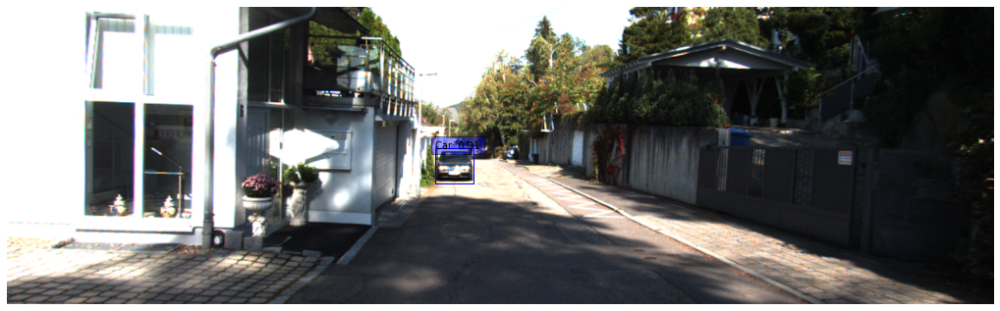

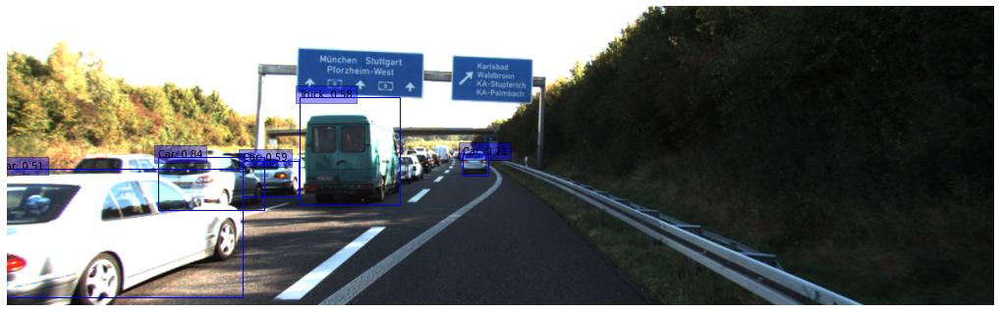

In [59]:
test_dataset = tfds.load("kitti", split="test", data_dir=DATA_PATH)
int2str = dataset_info.features["objects"]["type"].int2str

for sample in test_dataset.take(2):
    image = tf.cast(sample["image"], dtype=tf.float32)
    input_image, ratio = prepare_image(image)
    detections = inference_model.predict(input_image)
    num_detections = detections.valid_detections[0]
    class_names = [
        int2str(int(x)) for x in detections.nmsed_classes[0][:num_detections]
    ]
    visualize_detections(
        image,
        detections.nmsed_boxes[0][:num_detections] / ratio,
        class_names,
        detections.nmsed_scores[0][:num_detections],
        figsize=(18,7)
    )

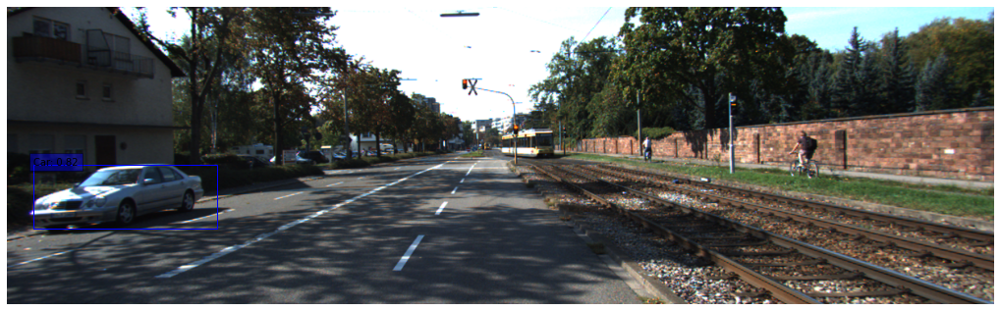

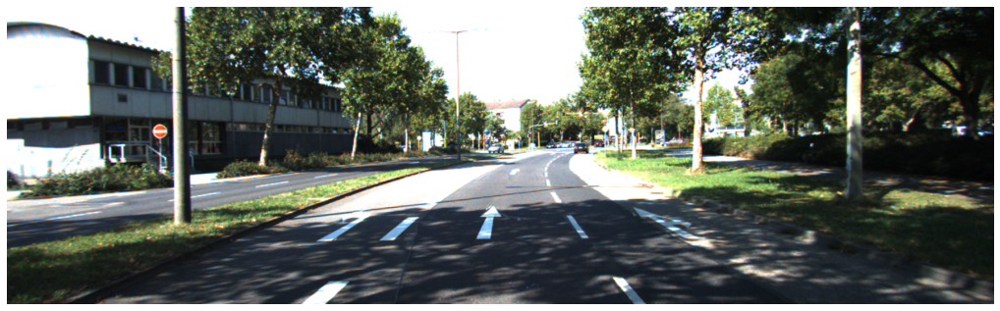

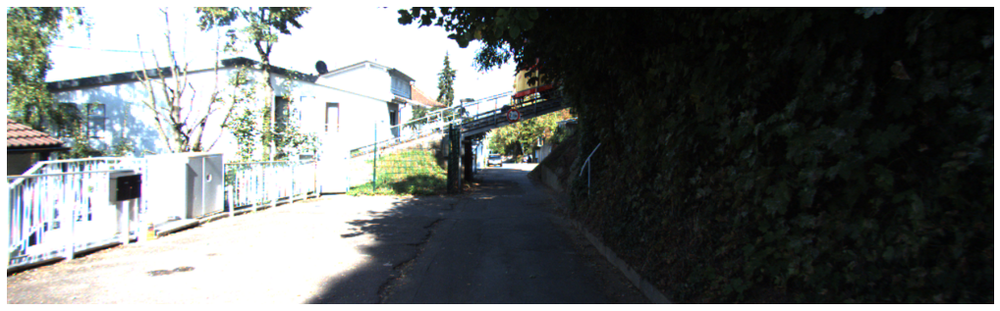

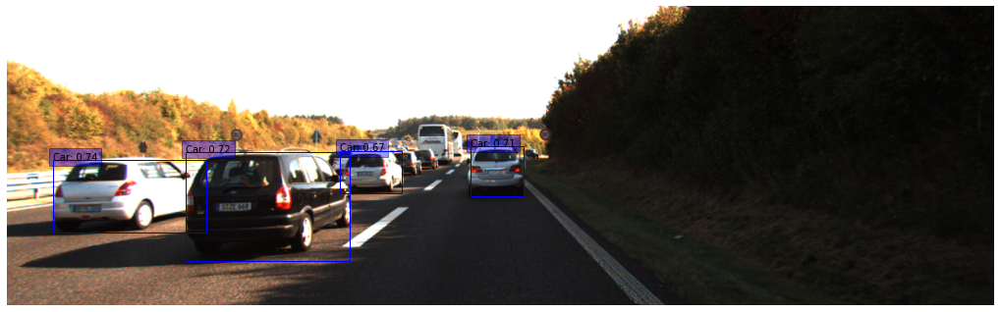

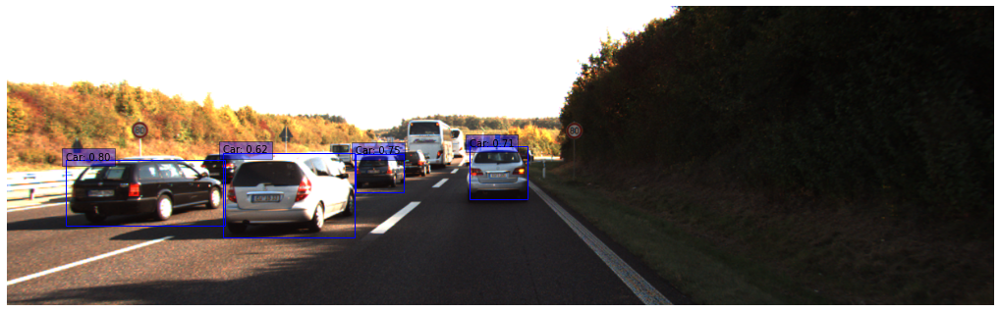

...

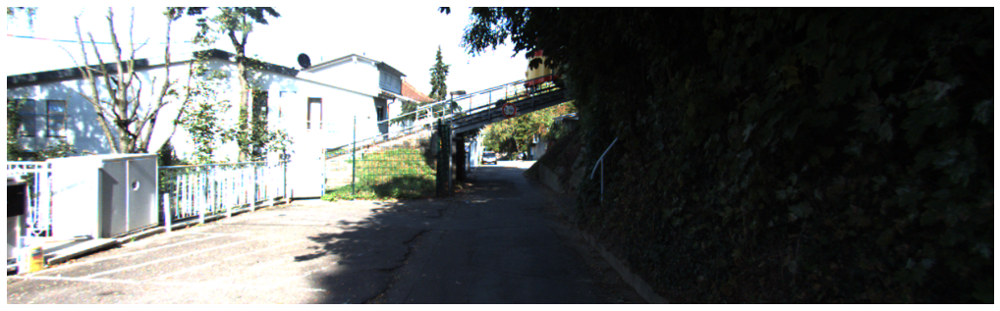

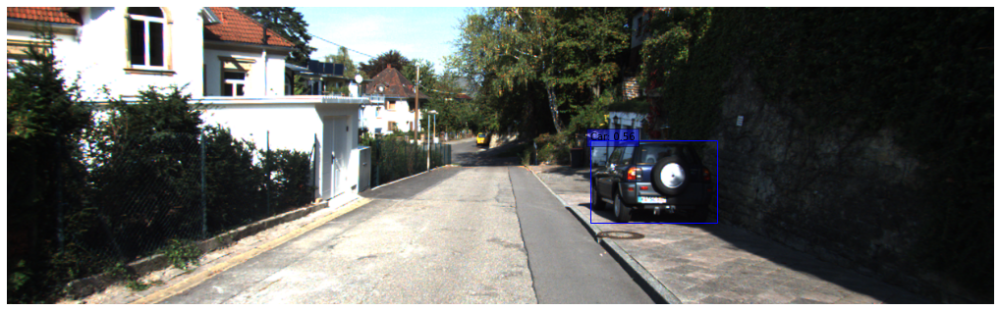

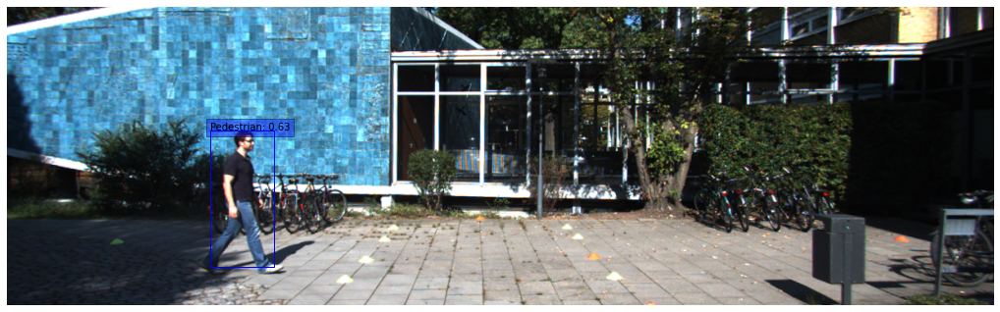

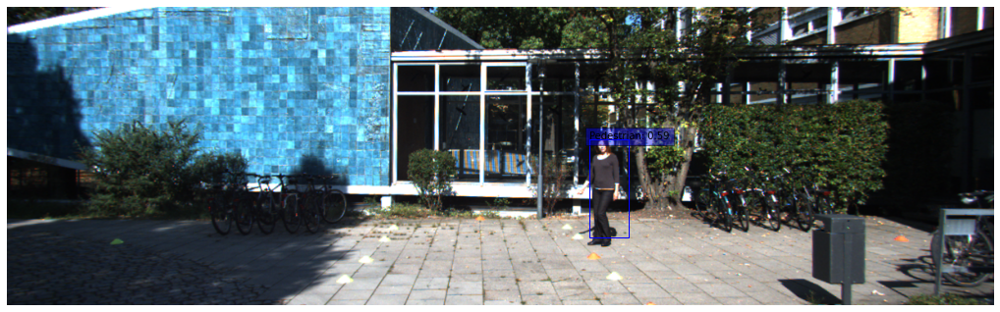

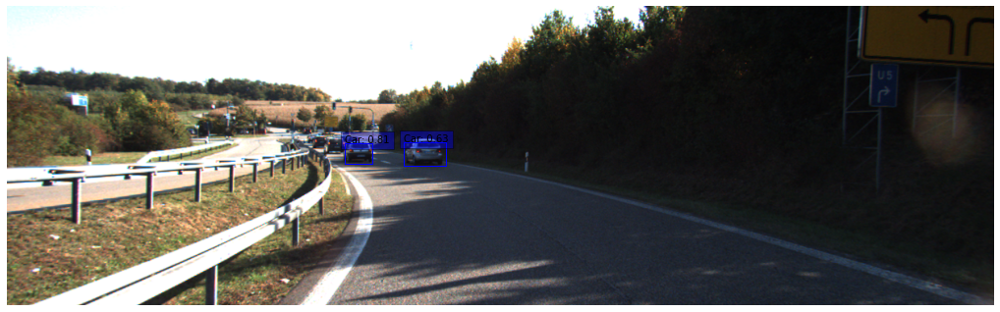

In [61]:
for sample in test_dataset.skip(2).take(20):
    image = tf.cast(sample["image"], dtype=tf.float32)
    input_image, ratio = prepare_image(image)
    detections = inference_model.predict(input_image)
    num_detections = detections.valid_detections[0]
    class_names = [
        int2str(int(x)) for x in detections.nmsed_classes[0][:num_detections]
    ]
    visualize_detections(
        image,
        detections.nmsed_boxes[0][:num_detections] / ratio,
        class_names,
        detections.nmsed_scores[0][:num_detections],
        figsize=(18, 7),
    )

> **note**:
> - 큰 흰 버스는 인식하지 못하는 것 같고, 사람의 경우도 크기가 굉장히 작으면 인식하지 못하는 것 같다.
> - 굉장히 멀리 있는 차는 인식하지 못하지만, 일반 차량의 경우 비교적 준수한 detection 능력을 보이는 것 같다.

### 7) 자율주행 시스템 만들기
---
- Go, Stop 함수 구현.
- Stop이 나와야 하는 조건은
  - 사람이 한 명 이상 있는 경우
  - 차량의 크기(width or height)가 300px이상인 경우

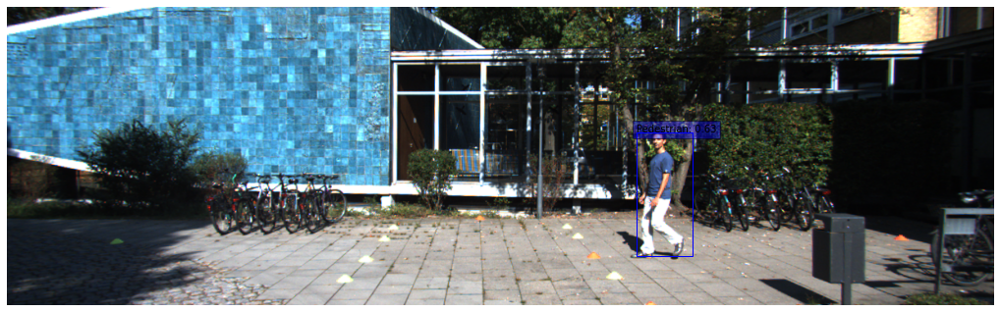

['Pedestrian'] are in the scene. Stop
Stop


In [62]:
# 예시 이미지
img_path = '/content/drive/My Drive/Aiffel/GD_08/kitti/stop_1.png'

# 함수 구현
def self_drive_assist(img_path, size_limit=300):
    # 코드 구현
        # 정지조건에 맞으면 return "Stop"
        # 아닌 경우 return "Go"
    image = Image.open(img_path)
    image = np.array(image)
    image = tf.cast(image, dtype=tf.float32)
    input_image, ratio = prepare_image(image)
    detections = inference_model.predict(input_image)
    num_detections = detections.valid_detections[0]
    class_names = [
        int2str(int(x)) for x in detections.nmsed_classes[0][:num_detections]
    ]

    # 추가
    bboxes = detections.nmsed_boxes[0][:num_detections] / ratio
    widths = bboxes[:, 3] - bboxes[:, 1]
    heights = bboxes[:, 2] - bboxes[:, 0]

    # 시각화
    visualize_detections(
        image,
        detections.nmsed_boxes[0][:num_detections] / ratio,
        class_names,
        detections.nmsed_scores[0][:num_detections],
        figsize=(18, 7),
    )    

    if 'Pedestrian' in class_names or 'Person_sitting' in class_names or 'Cyclist' in class_names:
        print(f"{class_names} are in the scene. Stop")
        return 'Stop'

    widest = 0
    highest = 0
    for cls, width, height in zip(class_names, widths, heights):
        if (cls == 'Car' or cls == 'Van' or cls == 'Truck' or cls == 'Tram') and (width >= 300 or height >= 300):
            if width > widest:
                widest = width
            if height > highest:
                highest = height
            print(f"{class_names} are too close. Width : {widest :.2f} and height : {highest :.2f}. Stop")
            return 'Stop'
        else:
            if width > widest:
                widest = width
            if height > highest:
                highest = height
            print("You may Go :)")
            print(f"Detected objects are {class_names} and the widest width : {widest :.2f} and the highest height : {highest :.2f}")
            return 'Go'
print(self_drive_assist(img_path))

### 8) 자율주행 시스템 평가하기
--- 
- 위에서 만든 함수를 토대로 주어진 사진 10개에 대한 모델의 예측률에 대해 평가한다.

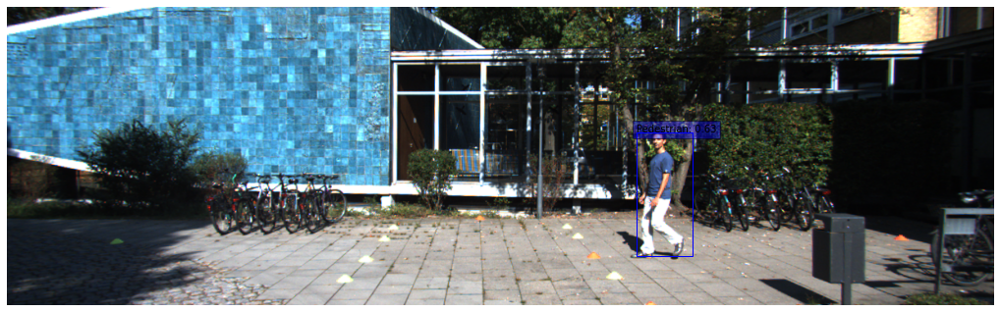

['Pedestrian'] are in the scene. Stop
Original answer : Stop




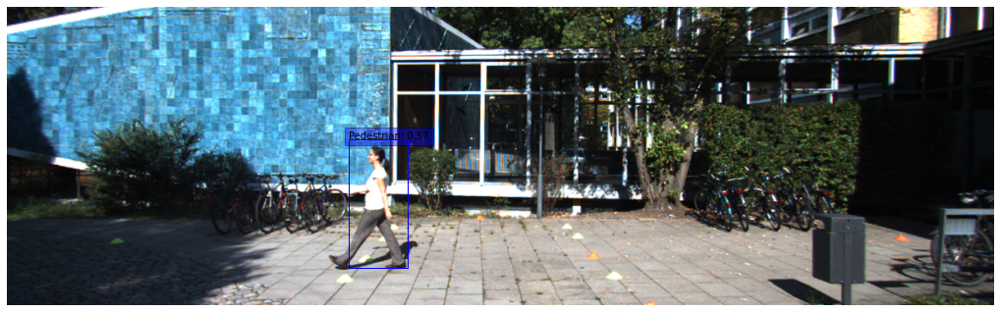

['Pedestrian'] are in the scene. Stop
Original answer : Stop




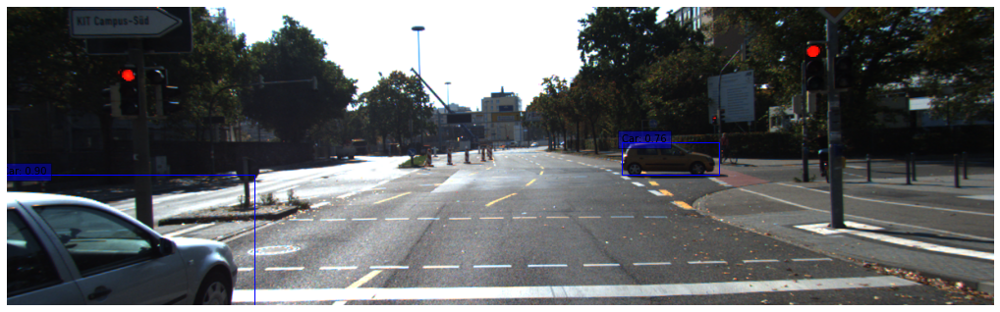

['Car', 'Car'] are too close. Width : 163.17 and height : 313.27. Stop
Original answer : Stop




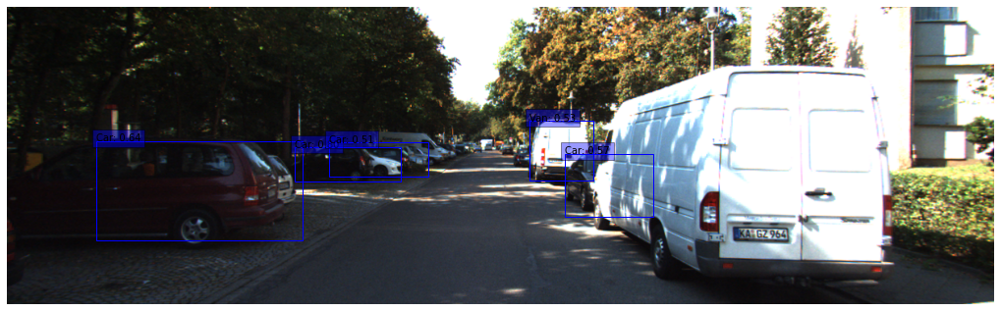

You may Go :)
Detected objects are ['Car', 'Car', 'Car', 'Van', 'Car'] and the widest width : 43.07 and the highest height : 133.09
Original answer : Stop




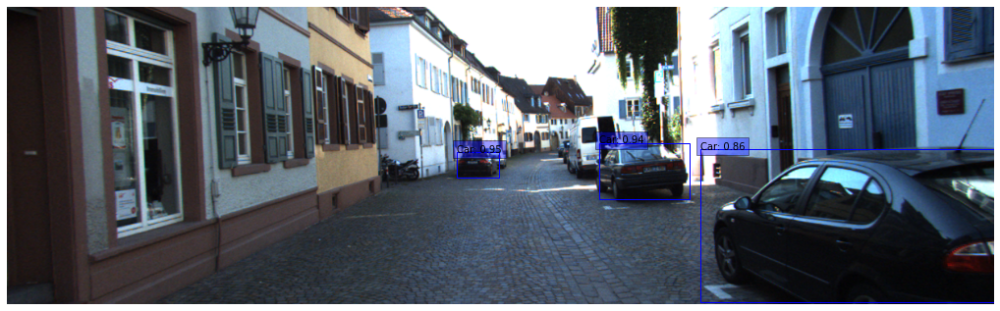

You may Go :)
Detected objects are ['Car', 'Car', 'Car'] and the widest width : 31.68 and the highest height : 52.86
Original answer : Stop




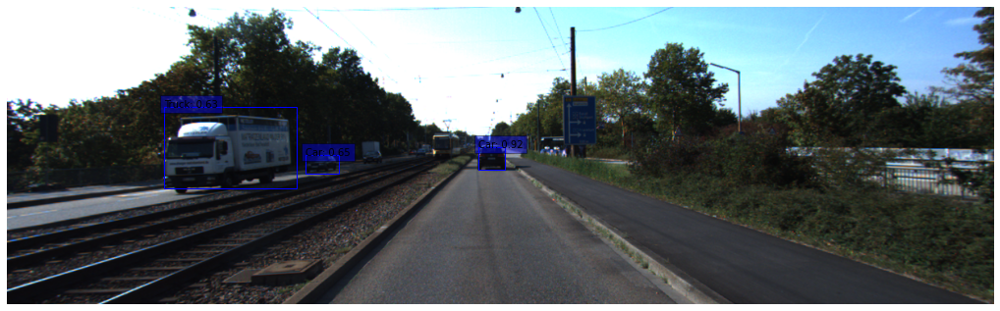

You may Go :)
Detected objects are ['Car', 'Car', 'Truck'] and the widest width : 28.68 and the highest height : 34.21
Original answer : Go




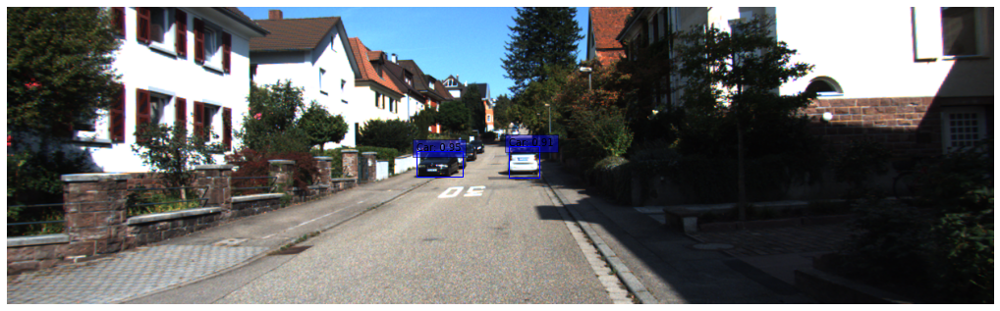

You may Go :)
Detected objects are ['Car', 'Car'] and the widest width : 33.07 and the highest height : 57.88
Original answer : Go




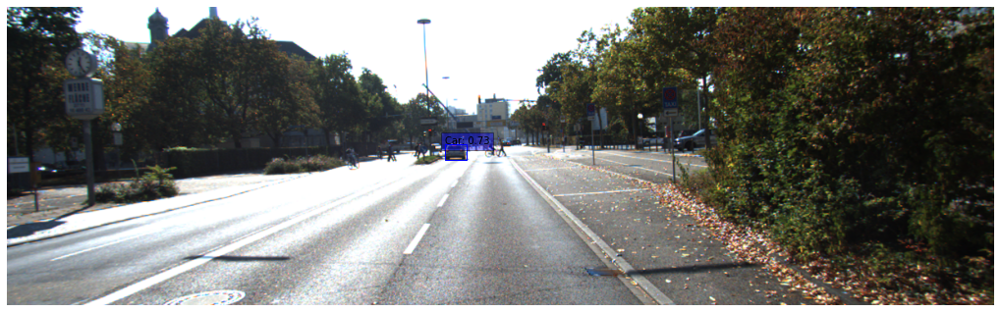

You may Go :)
Detected objects are ['Car'] and the widest width : 19.95 and the highest height : 27.84
Original answer : Go




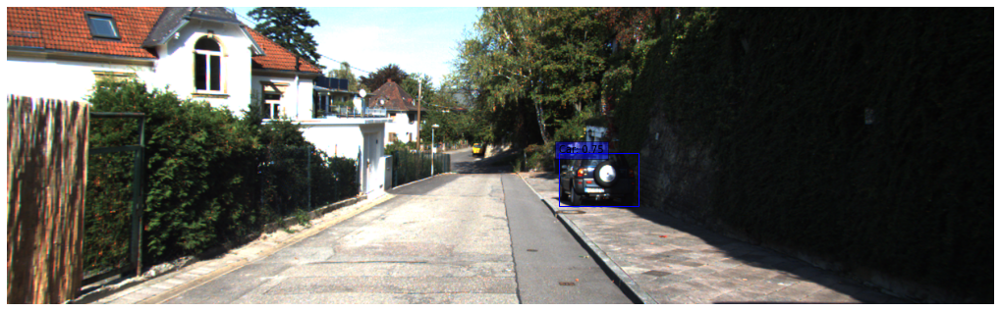

You may Go :)
Detected objects are ['Car'] and the widest width : 66.62 and the highest height : 100.02
Original answer : Go




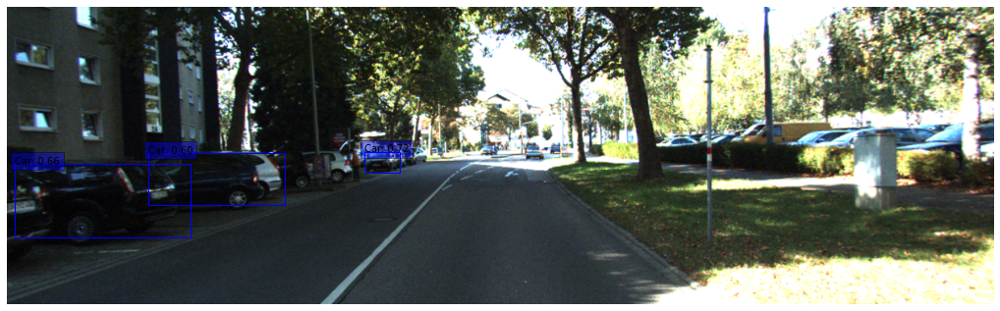

You may Go :)
Detected objects are ['Car', 'Car', 'Car'] and the widest width : 26.33 and the highest height : 45.14
Original answer : Go


80점입니다.


In [63]:
def test_system(func):
    work_dir = '/content/drive/My Drive/Aiffel/GD_08/kitti'
    score = 0
    test_set=[
        ("stop_1.png", "Stop"),
        ("stop_2.png", "Stop"),
        ("stop_3.png", "Stop"),
        ("stop_4.png", "Stop"),
        ("stop_5.png", "Stop"),
        ("go_1.png", "Go"),
        ("go_2.png", "Go"),
        ("go_3.png", "Go"),
        ("go_4.png", "Go"),
        ("go_5.png", "Go"),
    ]
    
    for image_file, answer in test_set:
        image_path = work_dir + '/' + image_file
        pred = func(image_path)
        print(f"Original answer : {answer}\n\n")
        if pred == answer:
            score += 10
    print(f"{score}점입니다.")

test_system(self_drive_assist)